In [1]:
# read in expression data from different tissue of 717

import numpy as np
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
%matplotlib inline
tissue_path = 'tissue_717_counts.tsv'
tissue = pd.read_csv(tissue_path, delimiter='\t')
tissue = tissue.set_index('gene')


In [2]:
# normalization between samples
# from https://www.oreilly.com/library/view/elegant-scipy/9781491922927/ch01.html
for col in tissue.columns:
    print(f"sum of all reads counts before normalization {sum(tissue[col])}")
    tissue[col] = (tissue[col] - tissue[col].mean()) / tissue[col].std()
    print(f"sum of all reads counts after normalization {sum(tissue[col])}")

sum of all reads counts before normalization 32615077
sum of all reads counts after normalization -7.152972658630574e-11
sum of all reads counts before normalization 33369670
sum of all reads counts after normalization 4.4005687982462405e-11
sum of all reads counts before normalization 44454658
sum of all reads counts after normalization -7.110126376552728e-11
sum of all reads counts before normalization 33167837
sum of all reads counts after normalization -3.0389218919069094e-11
sum of all reads counts before normalization 34733990
sum of all reads counts after normalization -7.279105096458238e-11
sum of all reads counts before normalization 38958591
sum of all reads counts after normalization -1.2169126817340725e-11
sum of all reads counts before normalization 42357470
sum of all reads counts after normalization 1.572403318661486e-11
sum of all reads counts before normalization 28262295
sum of all reads counts after normalization 1.1842837821518515e-10
sum of all reads counts before 

In [ ]:
# visualize the box plot of each tissue
# need fix

import matplotlib.pyplot as plt
from scipy import stats
# plt.style.use('style/elegant.mplstyle')
fig, ax = plt.subplots(figsize=(4.8, 2.4))
ax.boxplot(np.log(tissue + 1))

In [ ]:
tissue.shape
# 69k row
# 11 col

(69897, 11)

CPU times: user 499 ms, sys: 229 ms, total: 728 ms
Wall time: 205 ms


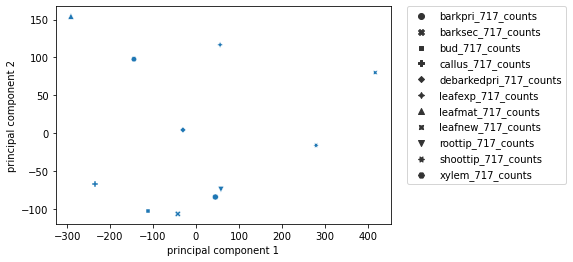

In [3]:
%%time

# PCA of samples
# PCA for dimension reduction for visualizing large dataset
# check out other more modern and trending reduction methods
# https://distill.pub/2016/misread-tsne/
# https://pair-code.github.io/understanding-umap/


from sklearn.preprocessing import StandardScaler
m717_data = tissue.values.transpose()
x = StandardScaler().fit_transform(m717_data)
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
principalDf['tissue'] = tissue.columns
sns.scatterplot(
    data=principalDf,
    x='principal component 1',
    y='principal component 2',
    style='tissue',
    # style='treatment'
)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

No handles with labels found to put in legend.


CPU times: user 349 ms, sys: 152 ms, total: 502 ms
Wall time: 122 ms


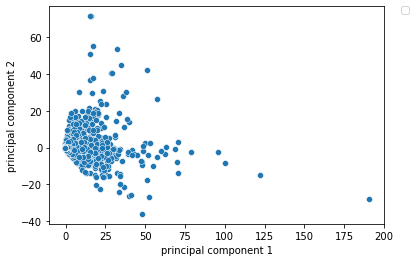

In [4]:
%%time

# PCA of genes

from sklearn.preprocessing import StandardScaler
m717_data = tissue.values
x = StandardScaler().fit_transform(m717_data)
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

sns.scatterplot(
    data=principalDf,
    x='principal component 1',
    y='principal component 2',
    # style='tissue',
    # style='treatment'
)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [5]:
%%time

# k means clustering

from sklearn.cluster import KMeans
# number of clusters
kmeans = KMeans(n_clusters=9)
kmeans.fit(tissue)
y_kmeans = kmeans.predict(tissue)
# plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, s=50, cmap='viridis')

# centers = kmeans.cluster_centers_

# plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);

CPU times: user 2.46 s, sys: 943 ms, total: 3.4 s
Wall time: 704 ms


In [ ]:
y_kmeans

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [ ]:
pd.DataFrame(y_kmeans).describe()

,0
count,69897.000000
mean,0.163770
std,0.710541
min,0.000000
25%,0.000000
50%,0.000000
75%,0.000000
max,8.000000


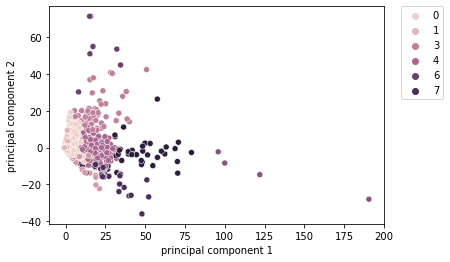

In [6]:
principalDf['cluster'] = y_kmeans
sns.scatterplot(
    data=principalDf,
    x='principal component 1',
    y='principal component 2',
    hue='cluster',
    # style='treatment'
)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)


# similar expression Pattern
# linear method: euclidean_distances, goemetry_distances, cosine_distances, manhattan_distances
# a= 3,5,3
# b= 9,9,9
# c= 2,6,4

In [9]:
# pick up one of the cluster and see how it looks like
tissue_cluster = tissue
tissue['cluster'] = y_kmeans
cluster_filter = (tissue['cluster'] == 3)
current_table = tissue[cluster_filter]

current_table = current_table.loc[(current_table!=0).any(axis=1)]
sns.clustermap(current_table,
#  standard_scale = 0,
    z_score=0,
    col_cluster = False,
    cmap = 'cividis'
#  row_cluster = False,

)

In [ ]:
# quantitative way to assess clustering
# in order to determine the best number of clusters
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

# put the above stuff into a for loop ?